In [1]:
%run preparation.py
%matplotlib inline

Conf0.1 shape before filter:  (301, 4)
Conf0.1 shape after filter:  (301, 4)
Conf0.2 shape before filter:  (301, 4)
Conf0.2 shape after filter:  (301, 4)
Conf0.3 shape before filter:  (301, 4)
Conf0.3 shape after filter:  (41, 4)
Conf0.4 shape before filter:  (301, 4)
Conf0.4 shape after filter:  (82, 4)
Conf0.5 shape before filter:  (301, 4)
Conf0.5 shape after filter:  (44, 4)
Conf0.6 shape before filter:  (301, 4)
Conf0.6 shape after filter:  (254, 4)
Conf0.7 shape before filter:  (301, 4)
Conf0.7 shape after filter:  (291, 4)
Conf0.8 shape before filter:  (301, 4)
Conf0.8 shape after filter:  (293, 4)
Conf0.9 shape before filter:  (301, 4)
Conf0.9 shape after filter:  (295, 4)
Conf1.0 shape before filter:  (301, 4)
Conf1.0 shape after filter:  (298, 4)


In [2]:
columns = ['time', 'x_tip', 'y_tip']
df_load = pd.read_csv('TipXY_A001_r0.1.txt', names=columns, delim_whitespace=True)
df_nice = df_load.drop(['time'], axis=1)
df = df_nice.iloc[0::10, :]
df.to_csv('SkippedTipXY_A001.csv', encoding='utf-8', index=False)

In [3]:
Dx_tip = np.diff(df['x_tip']); Dy_tip = np.diff(df['y_tip'])
DD=np.sqrt((Dx_tip**2)+(Dy_tip**2))
np.savetxt('DD_A001.csv', DD, delimiter=',')
v=DD/(10*dt); Av_vel = np.mean(v)
np.savetxt('v.csv', v, delimiter=',')
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

Ave_vel:  0.11145858362603829
VSD:  0.05837139284648545


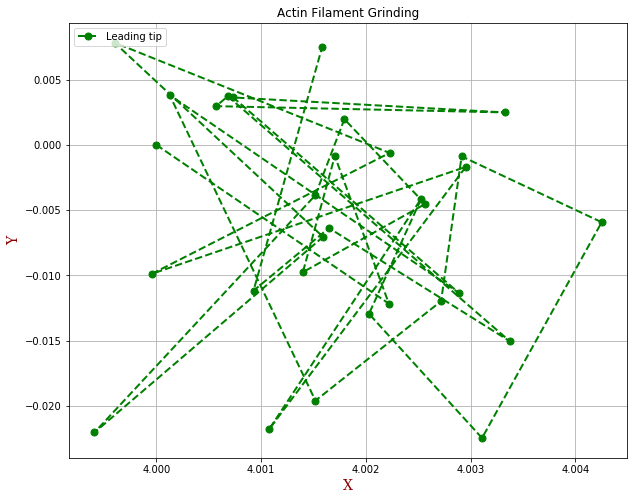

In [4]:
plt.figure(figsize=(10,8))
#plt.text(6, 8, 'Av_Vel = ', fontdict=font); plt.text(8, 8, '%.5f'%Av_vel, fontdict=font)
#plt.text(6, 7, 'Vel_SD = ', fontdict=font); plt.text(8, 7, '%.5f'%vSD, fontdict=font)
plt.plot(df['x_tip'],df['y_tip'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Grinding'); plt.legend(loc='upper left'); plt.grid()
#plt.savefig('actin_graph.svg', format='svg', dpi=1200)
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

Ave_vel:  0.9264735240450269
VSD:  0.6265233020031812


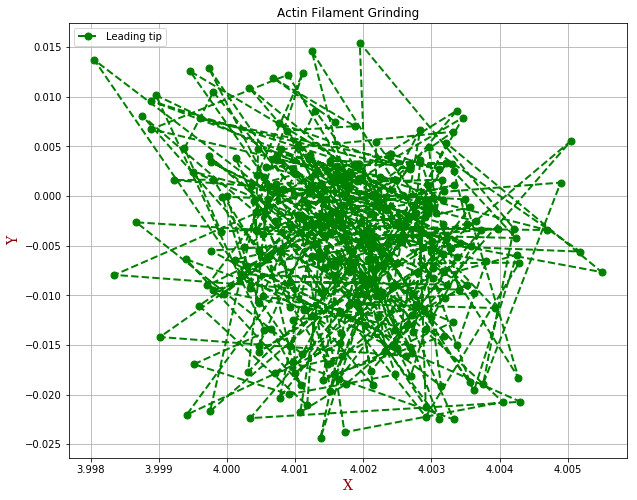

In [5]:
index_diff01 = np.diff(df01.index) # difference in index between one row and next
Dx = np.diff(df01['x']); Dy = np.diff(df01['y']) # value difference between one row and next
DD=np.sqrt((Dx**2)+(Dy**2)) # calculate distance 
v=DD/(index_diff01*dt); Av_vel = np.mean(v) # calculate velocity and mean
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD) # calculate standard deviation

plt.figure(figsize=(10,8))
plt.plot(df01['x'],df01['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Grinding'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

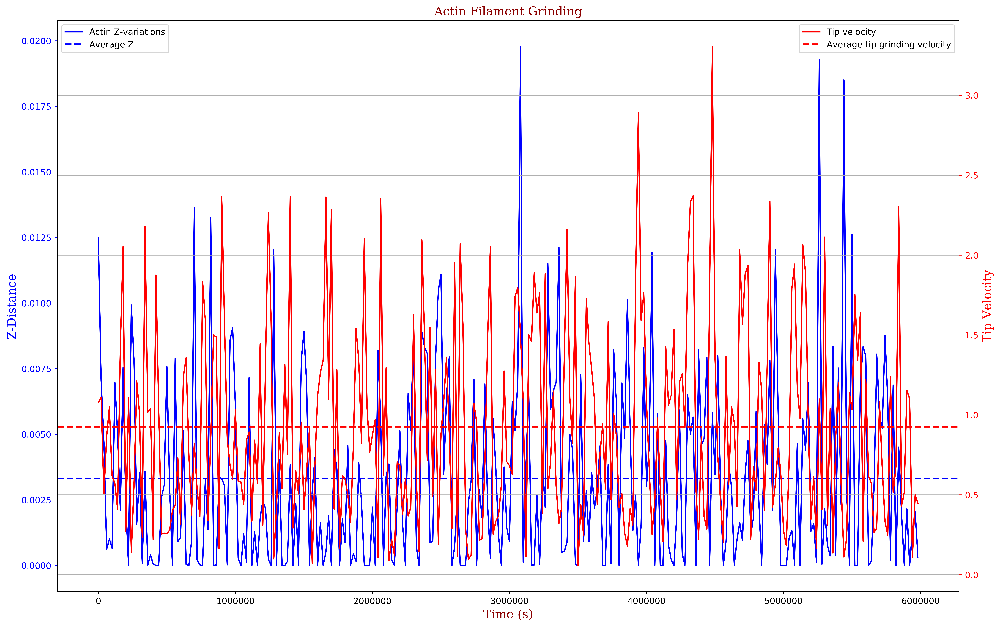

In [6]:
df01_ = df01.drop(df01.index[300]) # drop the last row to match vel shape
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df01_['time'],df01_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df01_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df01_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

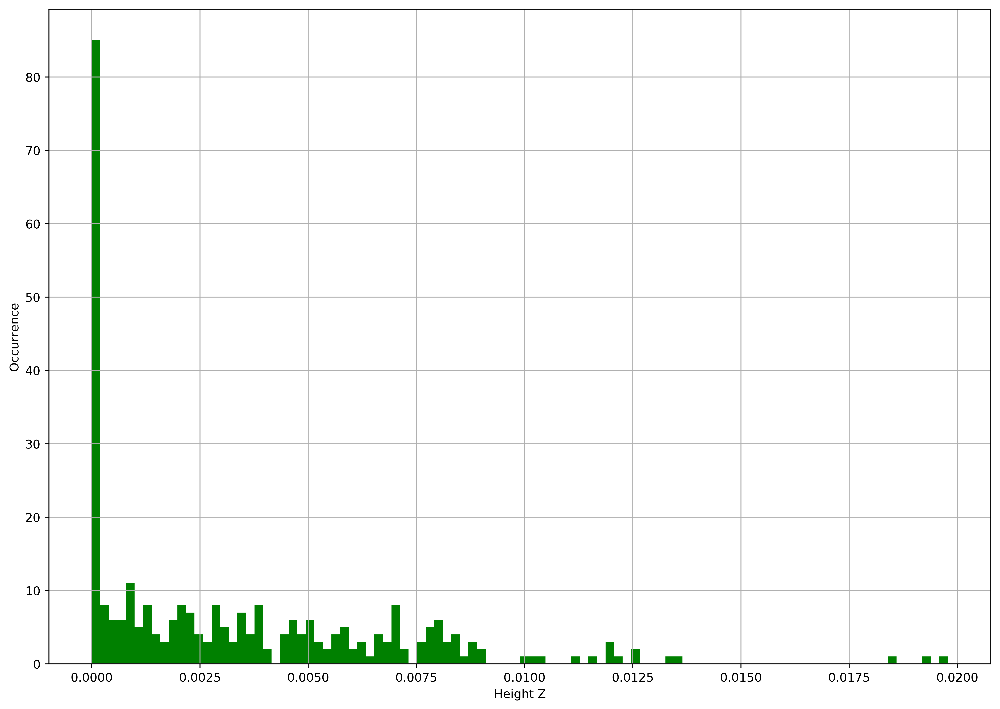

In [7]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df01['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  3.216799964173127
VSD:  3.0764013170929148


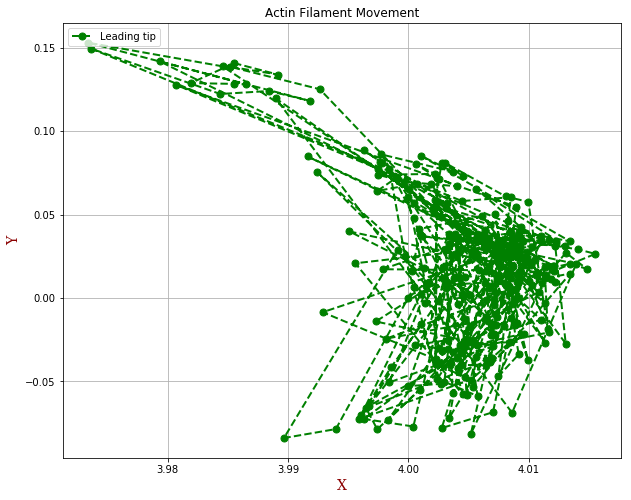

In [8]:
index_diff02 = np.diff(df02.index)
Dx = np.diff(df02['x']); Dy = np.diff(df02['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff02*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df02['x'],df02['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

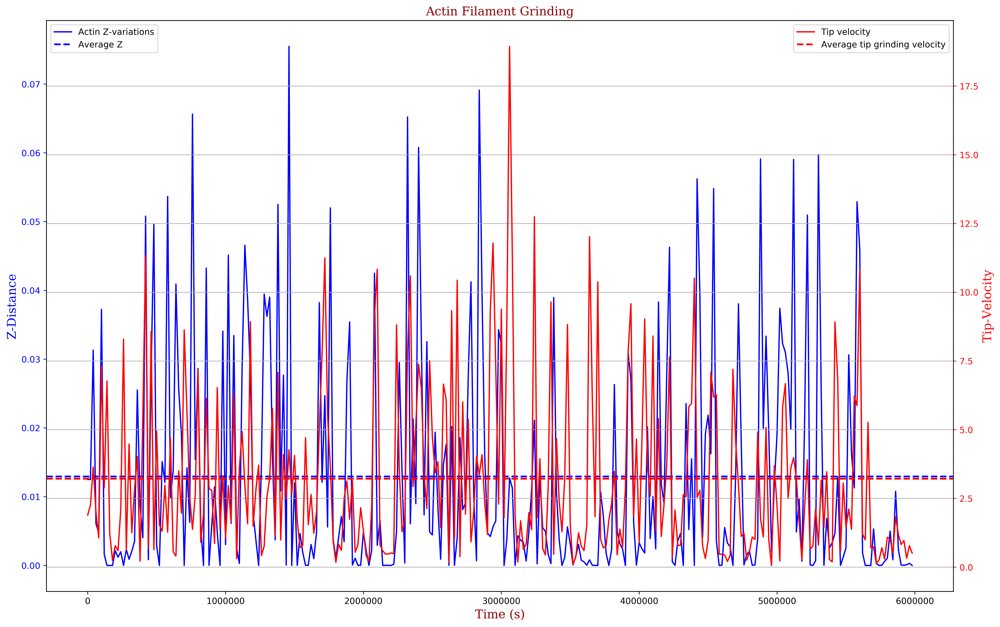

In [9]:
df02_ = df02.drop(df02.index[300])
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df02_['time'],df02_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df02_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df02_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

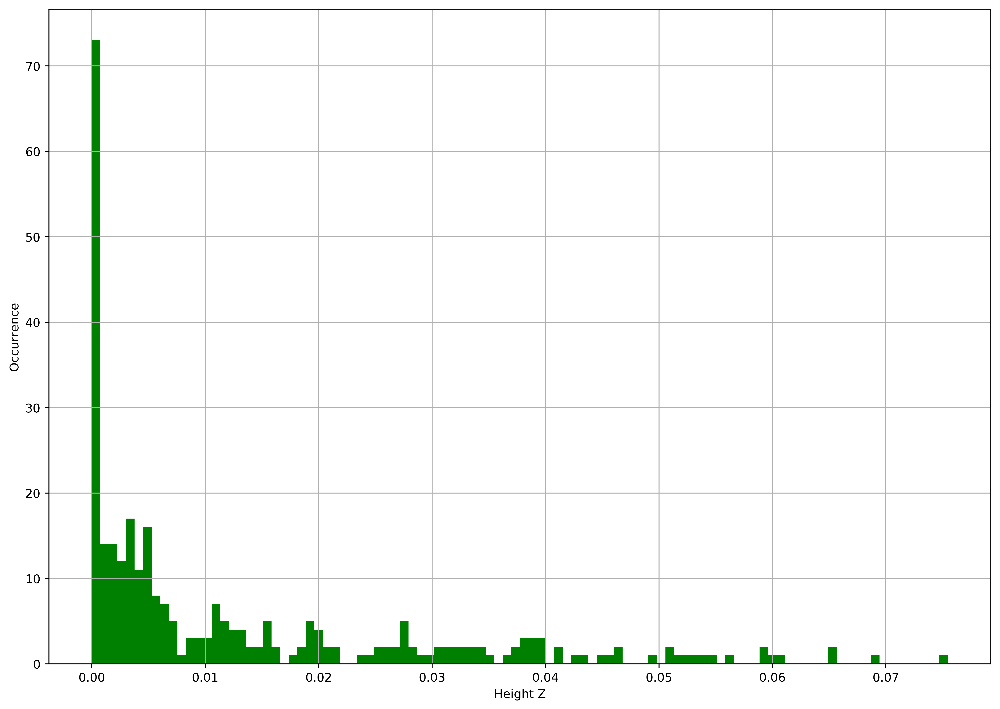

In [10]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df02['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  9.50190705925856
VSD:  11.11691495802427


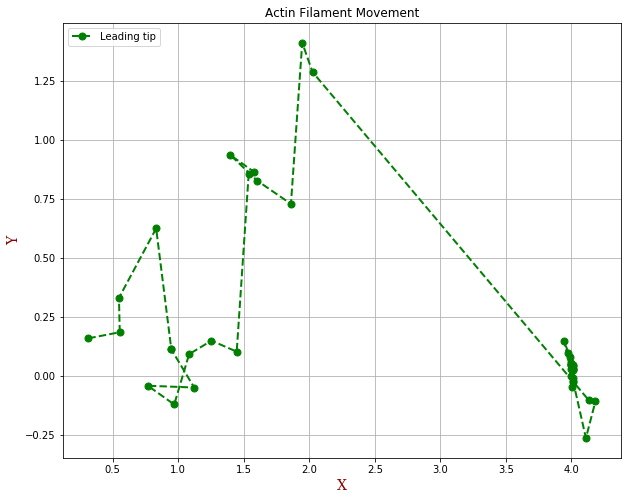

In [11]:
index_diff03 = np.diff(df03.index)
Dx = np.diff(df03['x']); Dy = np.diff(df03['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff03*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df03['x'],df03['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

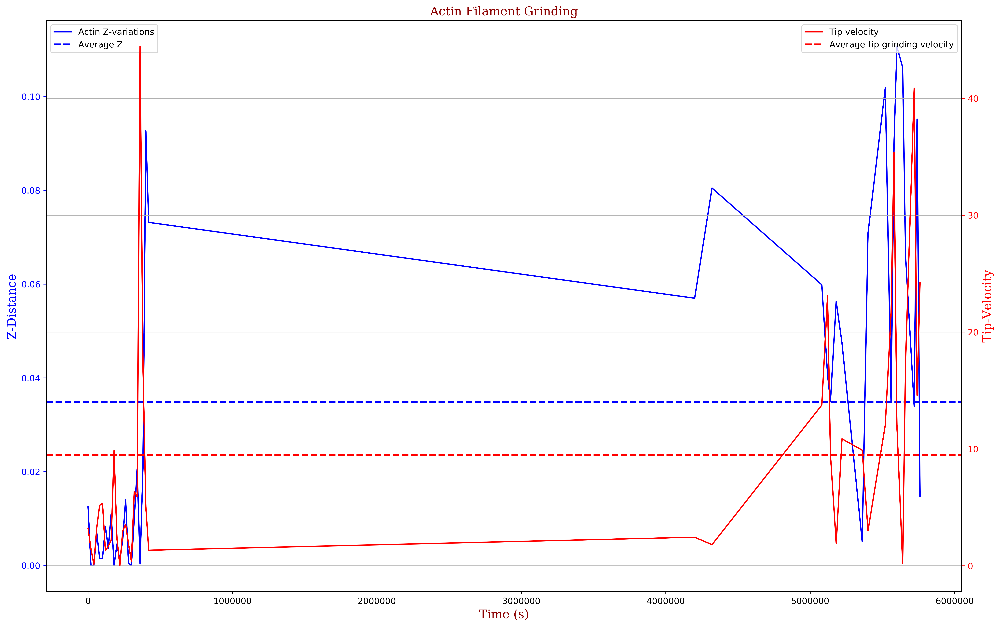

In [12]:
df03_ = df03.drop(df03.index[40]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df03_['time'],df03_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df03_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df03_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

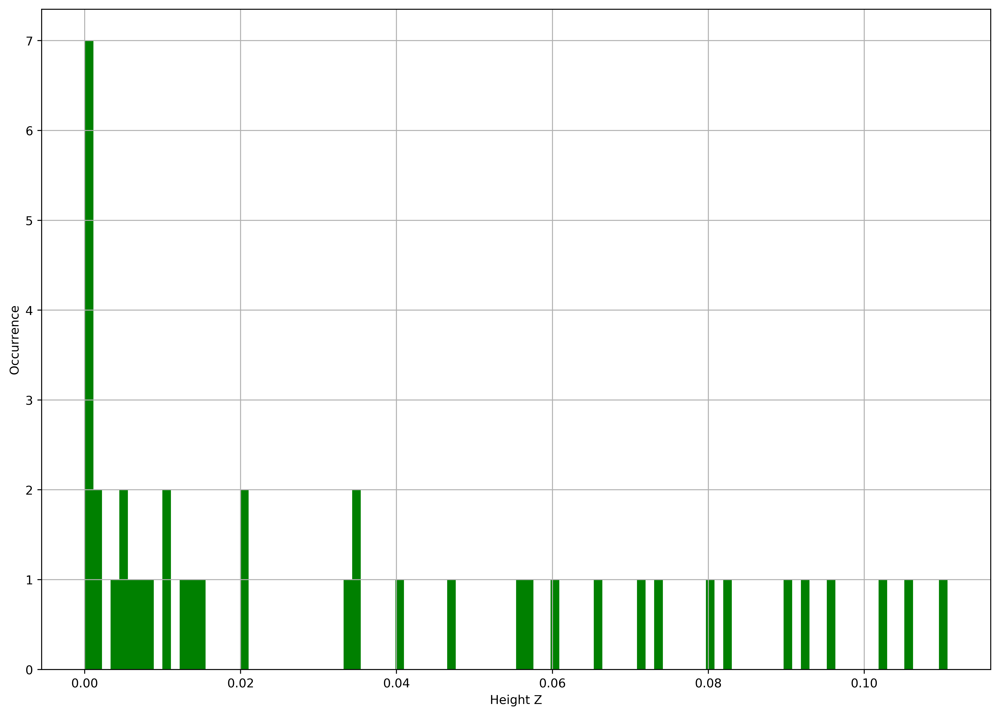

In [13]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df03['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  12.409646552649724
VSD:  11.093747956924846


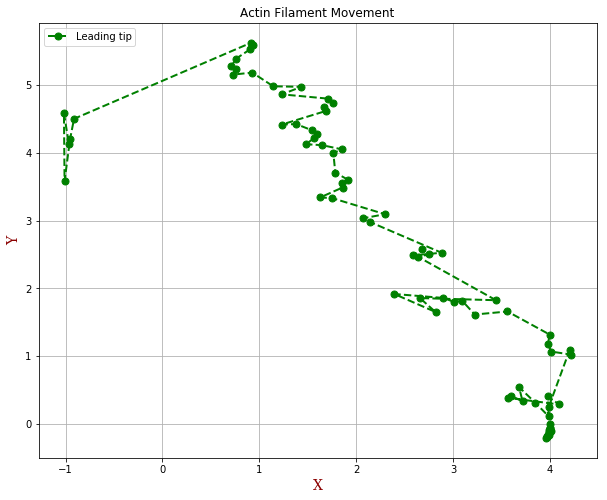

In [14]:
index_diff04 = np.diff(df04.index)
Dx = np.diff(df04['x']); Dy = np.diff(df04['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff04*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df04['x'],df04['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

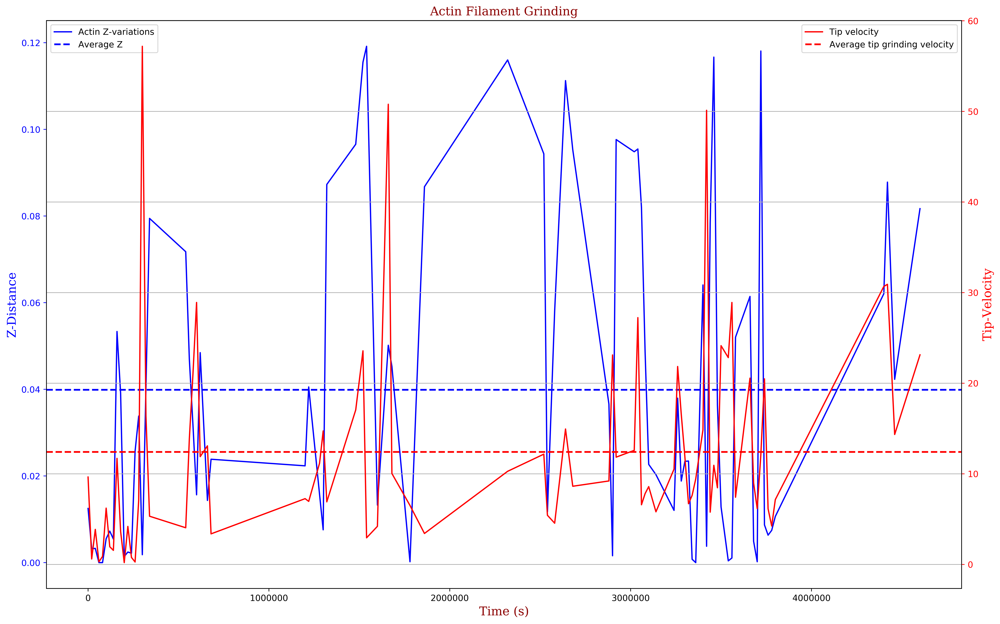

In [15]:
df04_ = df04.drop(df04.index[81]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df04_['time'],df04_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df04_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df04_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

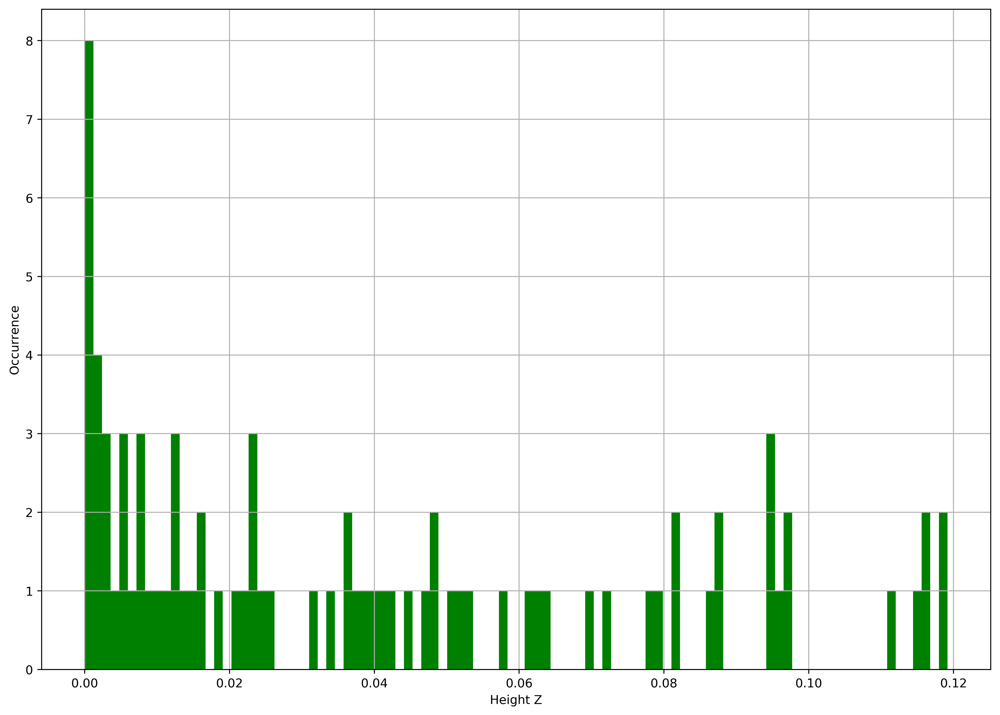

In [16]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df04['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  10.53953829421381
VSD:  8.713125283876595


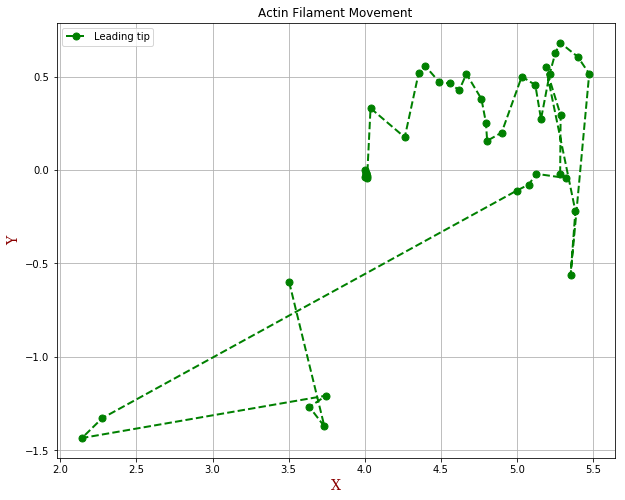

In [17]:
index_diff05 = np.diff(df05.index)
Dx = np.diff(df05['x']); Dy = np.diff(df05['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff05*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df05['x'],df05['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

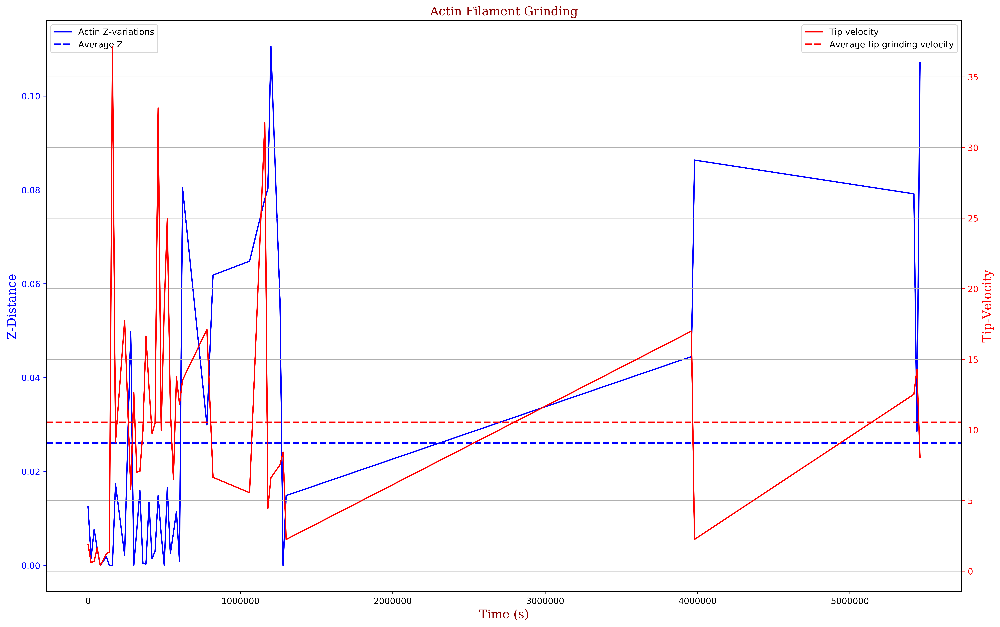

In [18]:
df05_ = df05.drop(df05.index[43]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df05_['time'],df05_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df05_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df05_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

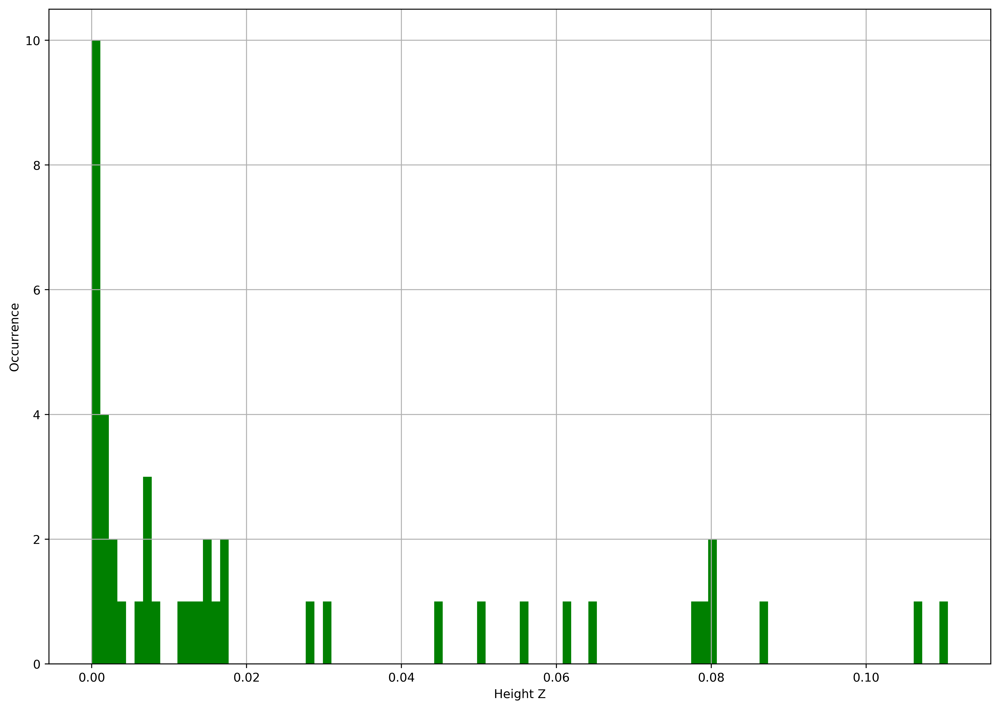

In [19]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df05['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  13.165139831936234
VSD:  8.141510154048126


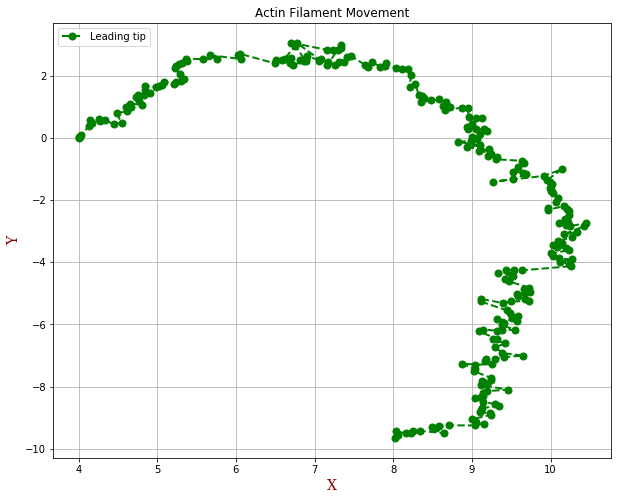

In [20]:
index_diff06 = np.diff(df06.index)
Dx = np.diff(df06['x']); Dy = np.diff(df06['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff06*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df06['x'],df06['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

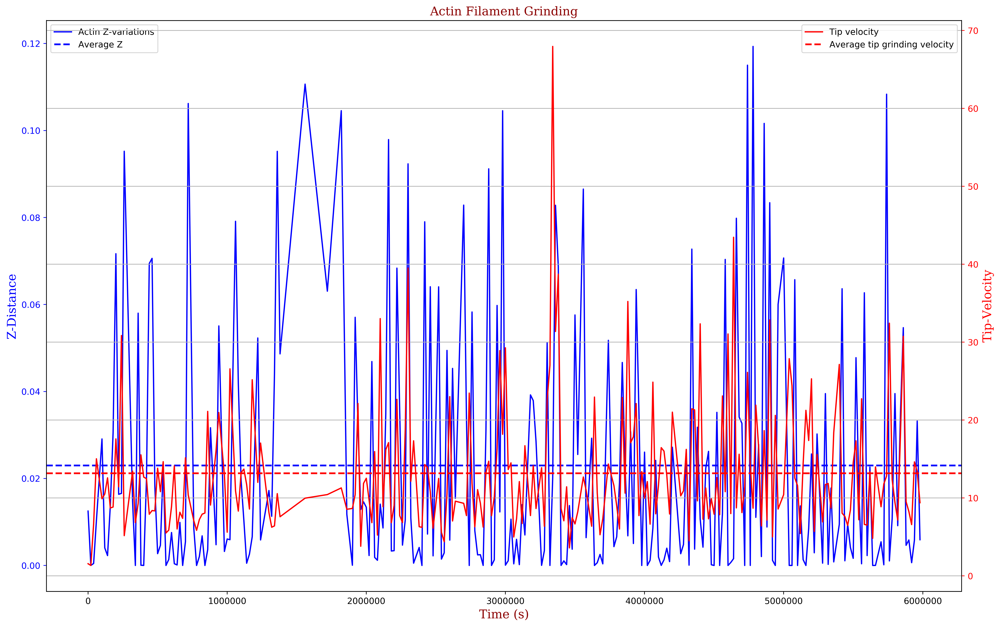

In [21]:
df06_ = df06.drop(df06.index[253]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df06_['time'],df06_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df06_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df06_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

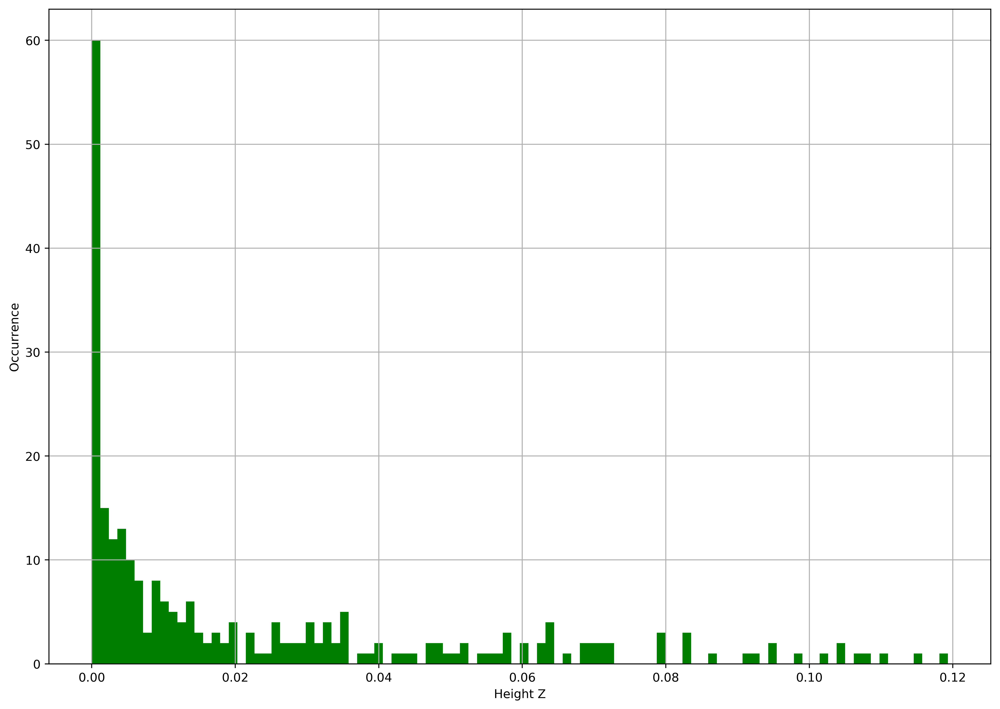

In [22]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df06['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  12.33191415418844
VSD:  7.505000160488821


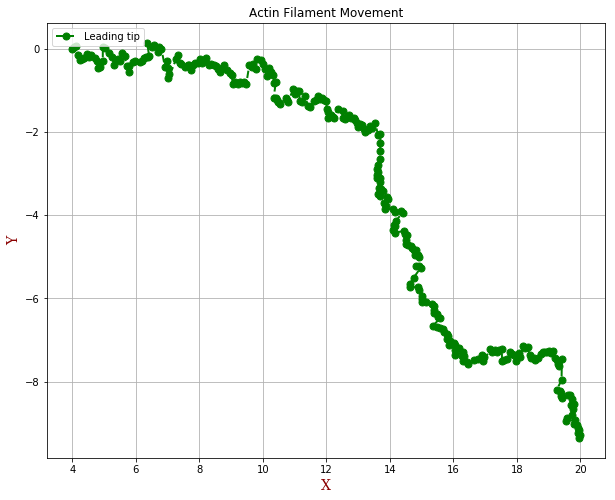

In [23]:
index_diff07 = np.diff(df07.index)
Dx = np.diff(df07['x']); Dy = np.diff(df07['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff07*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df07['x'],df07['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

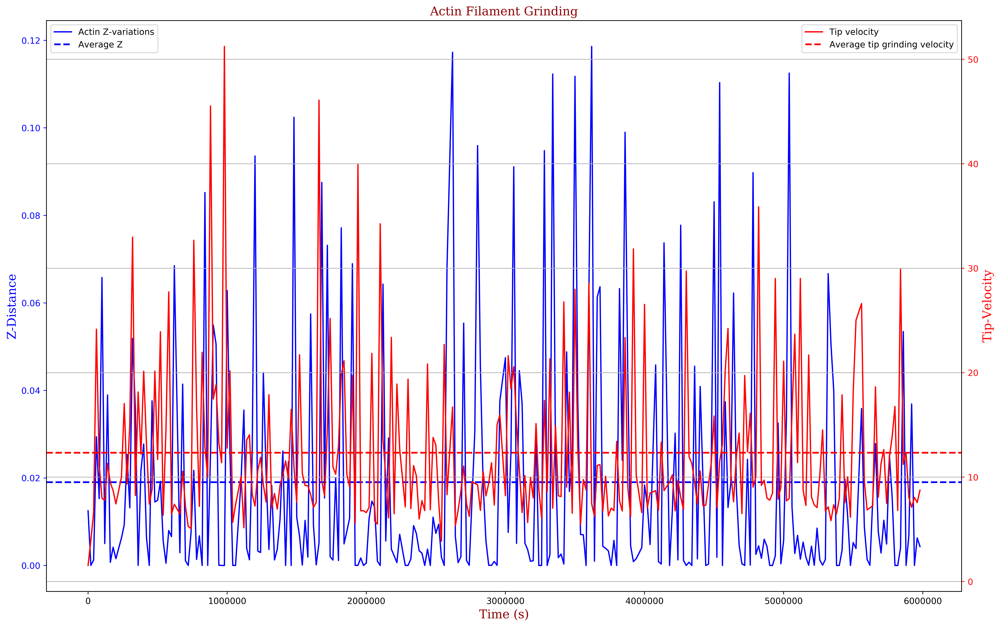

In [24]:
df07_ = df07.drop(df07.index[290]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df07_['time'],df07_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df07_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df07_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

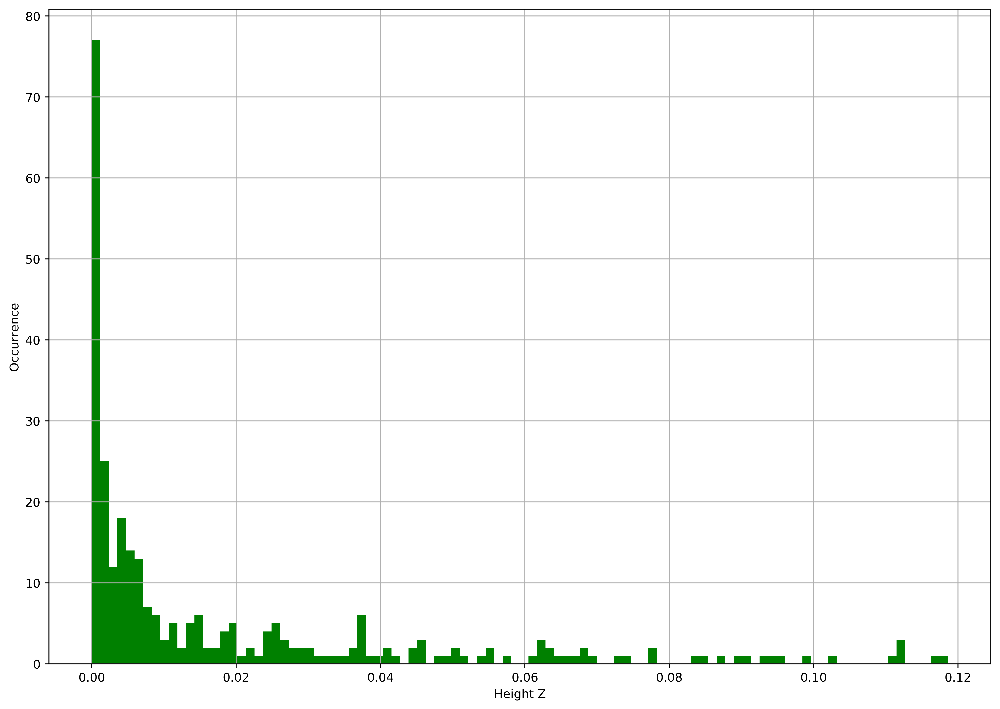

In [25]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df07['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  11.691965618426297
VSD:  7.248935548162617


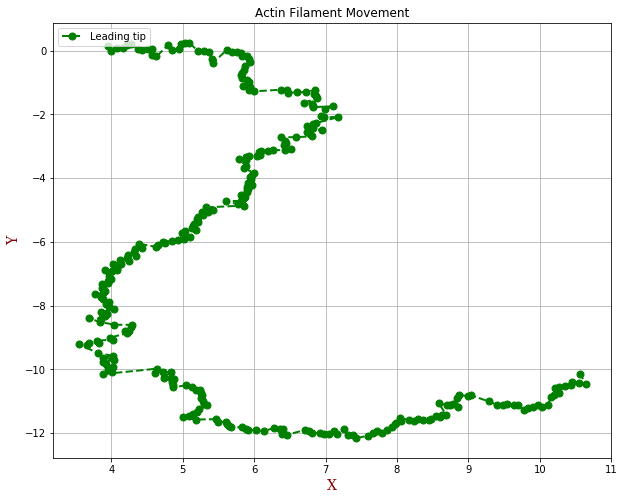

In [26]:
index_diff08 = np.diff(df08.index)
Dx = np.diff(df08['x']); Dy = np.diff(df08['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff08*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df08['x'],df08['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

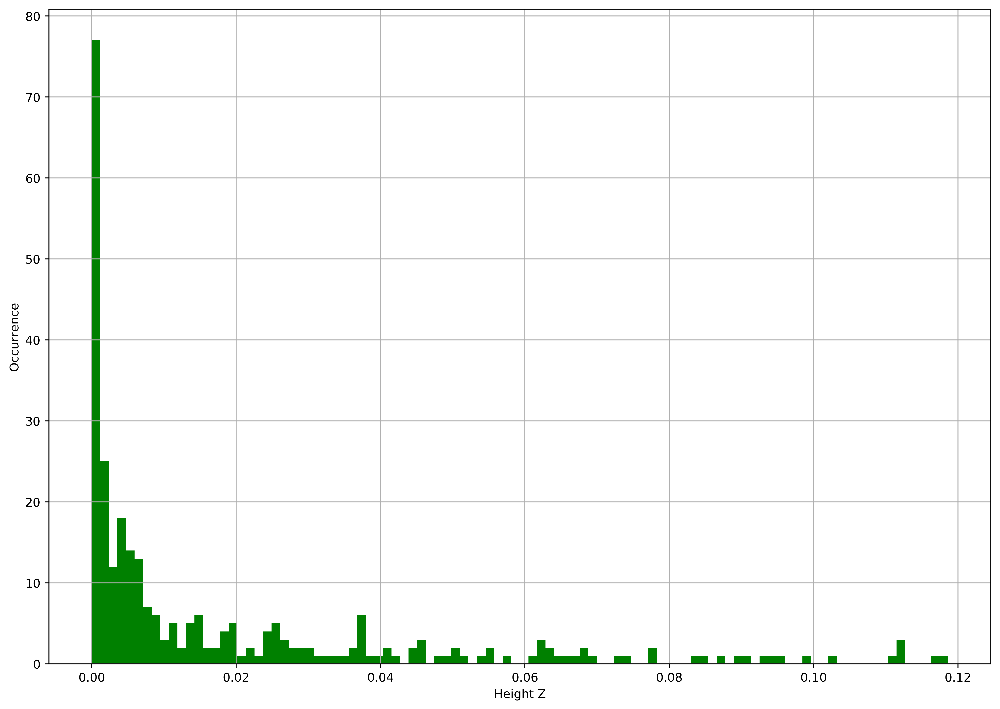

In [27]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df07['z'].hist(bins=100, ax=ax, color='green')

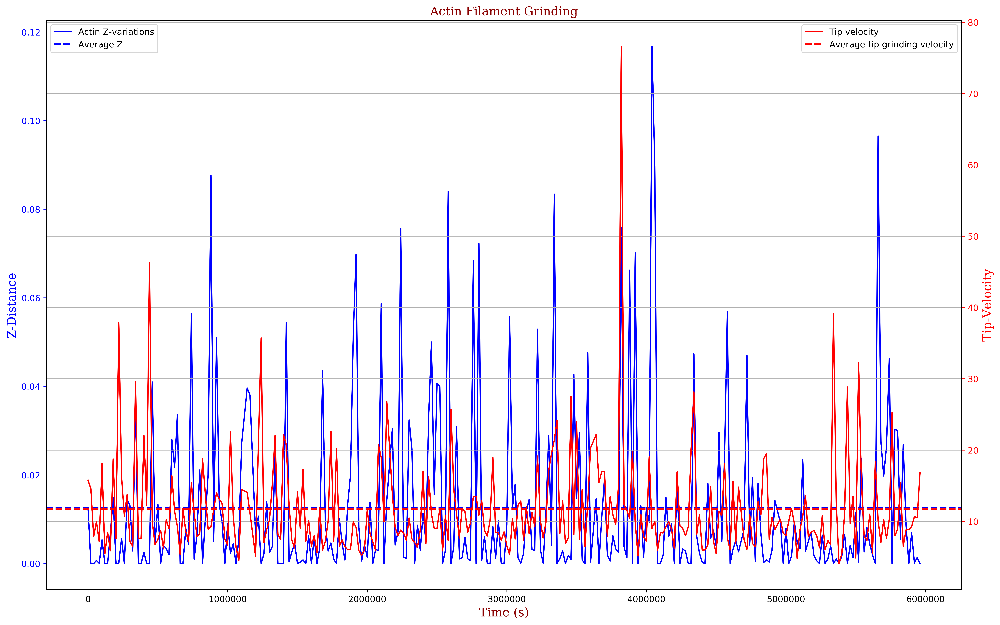

In [28]:
df08_ = df08.drop(df08.index[292]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df08_['time'],df08_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df08_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df08_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

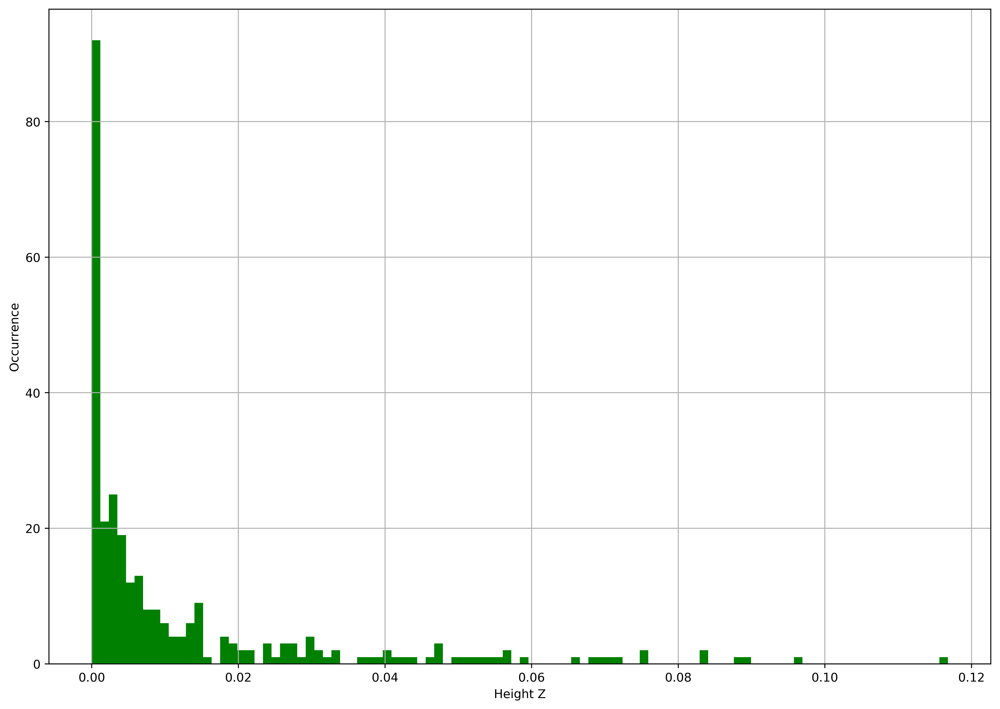

In [29]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df08['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  11.316034120970297
VSD:  6.288090934188312


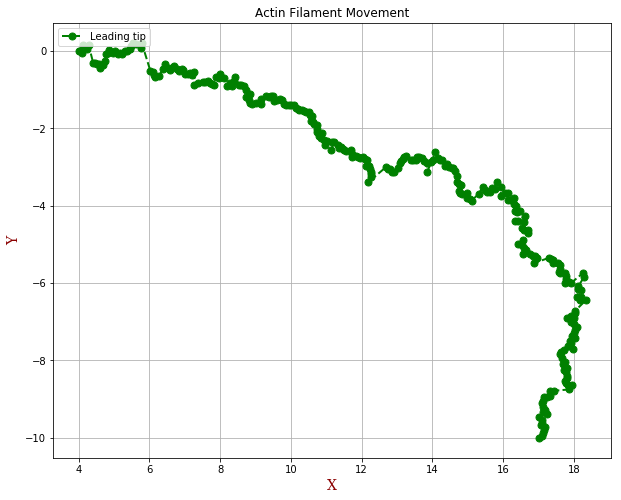

In [30]:
index_diff09 = np.diff(df09.index)
Dx = np.diff(df09['x']); Dy = np.diff(df09['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff09*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df09['x'],df09['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

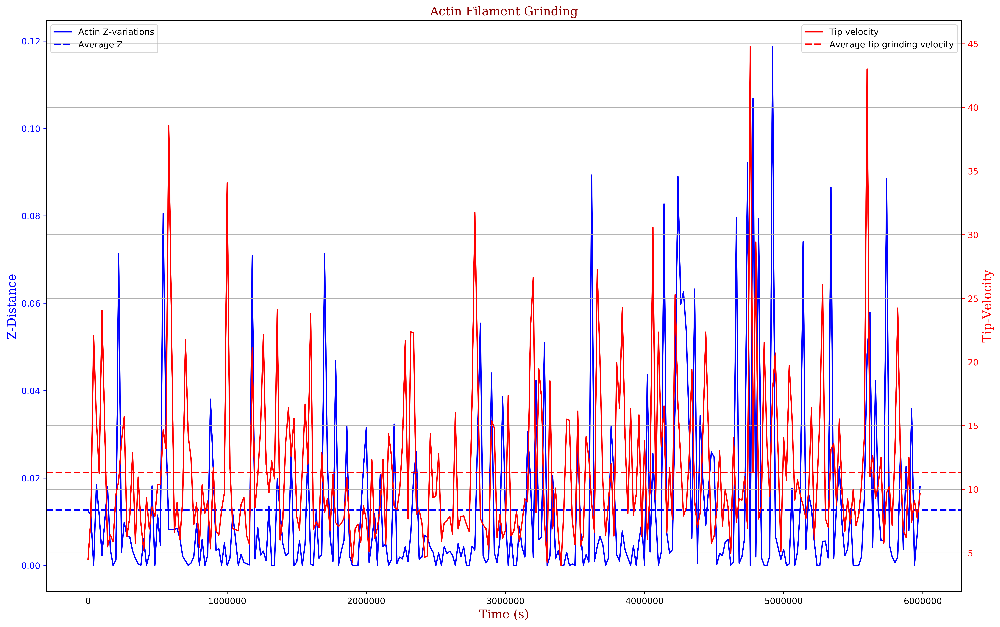

In [31]:
df09_ = df09.drop(df09.index[294]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df09_['time'],df09_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df09_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df09_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

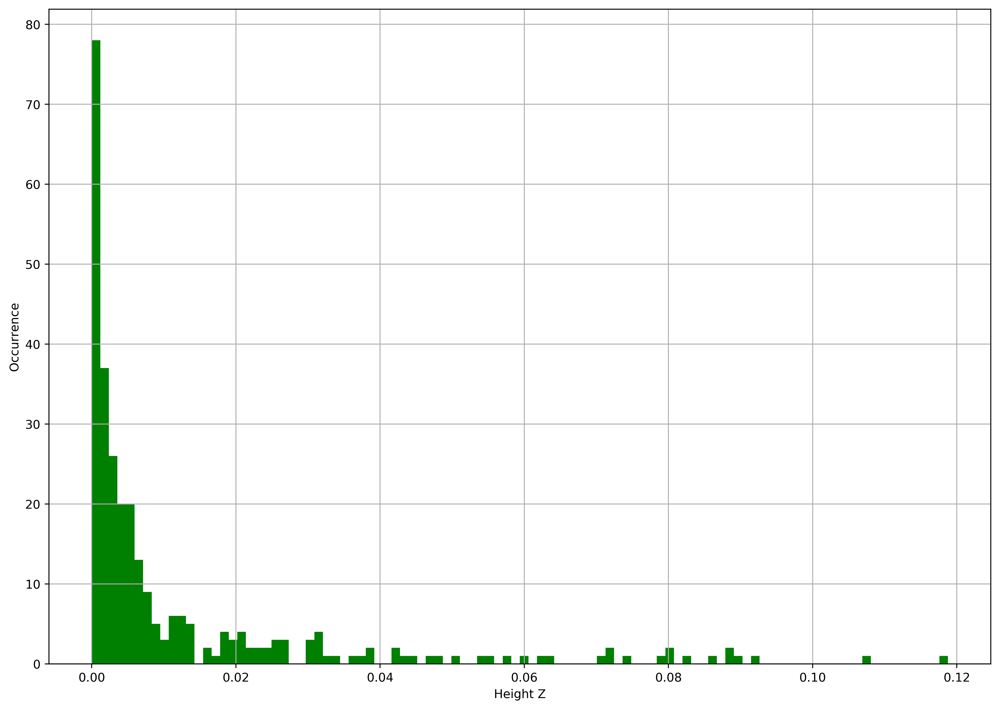

In [32]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df09['z'].hist(bins=100, ax=ax, color='green')

Ave_vel:  10.834874773271228
VSD:  5.646034608042509


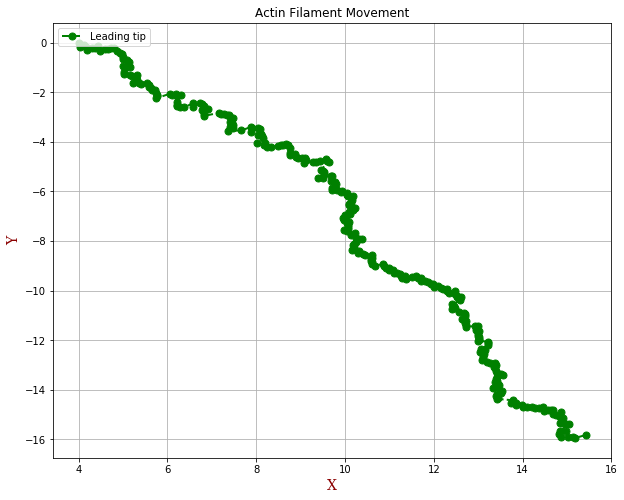

In [33]:
index_diff10 = np.diff(df10.index)
Dx = np.diff(df10['x']); Dy = np.diff(df10['y'])
DD=np.sqrt((Dx**2)+(Dy**2))
v=DD/(index_diff10*dt); Av_vel = np.mean(v)
vSD=np.sum(((v-Av_vel)**2)/(np.size(v)-1)); vSD=np.sqrt(vSD)

plt.figure(figsize=(10,8))
plt.plot(df10['x'],df10['y'], label='Leading tip', color='green', marker='o', linestyle='dashed', linewidth=2, markersize=7)
plt.xlabel('X', fontdict=font); plt.ylabel('Y', fontdict=font)
plt.title('Actin Filament Movement'); plt.legend(loc='upper left'); plt.grid()
print('Ave_vel: ', Av_vel)
print('VSD: ', vSD)

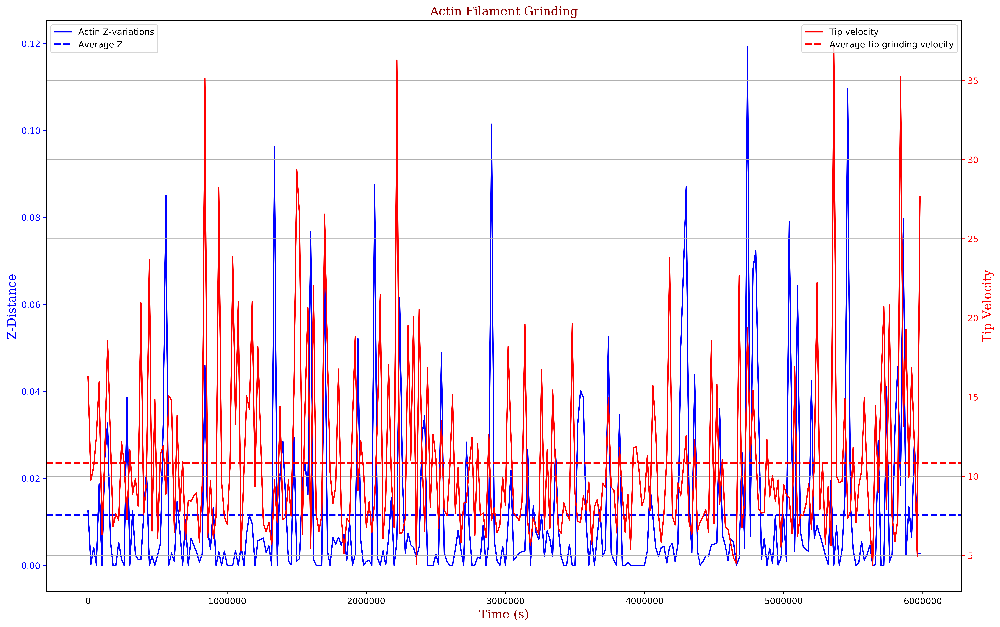

In [34]:
df10_ = df10.drop(df10.index[297]) 
fig, ax1 = plt.subplots(dpi=500)
ax1.plot(df10_['time'],df10_['z'], 'b', label='Actin Z-variations')
ax1.axhline(df10_['z'].mean(), linestyle='--', linewidth=2, color='b', label='Average Z')
ax1.set_xlabel('Time (s)',fontdict=font)
ax1.set_ylabel('Z-Distance', color='b',fontdict=font)
ax1.tick_params('y', colors='b')
plt.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(df10_['time'],v, 'r', label='Tip velocity')
ax2.axhline(Av_vel, linestyle='--', linewidth=2, color='r', label='Average tip grinding velocity')
fig.set_size_inches([16, 10])
fig.tight_layout()
ax2.set_ylabel('Tip-Velocity', color='r',fontdict=font)
ax2.tick_params('y', colors='r')
plt.title('Actin Filament Grinding',fontdict=font); plt.legend(loc='upper right')
plt.grid(); plt.show()

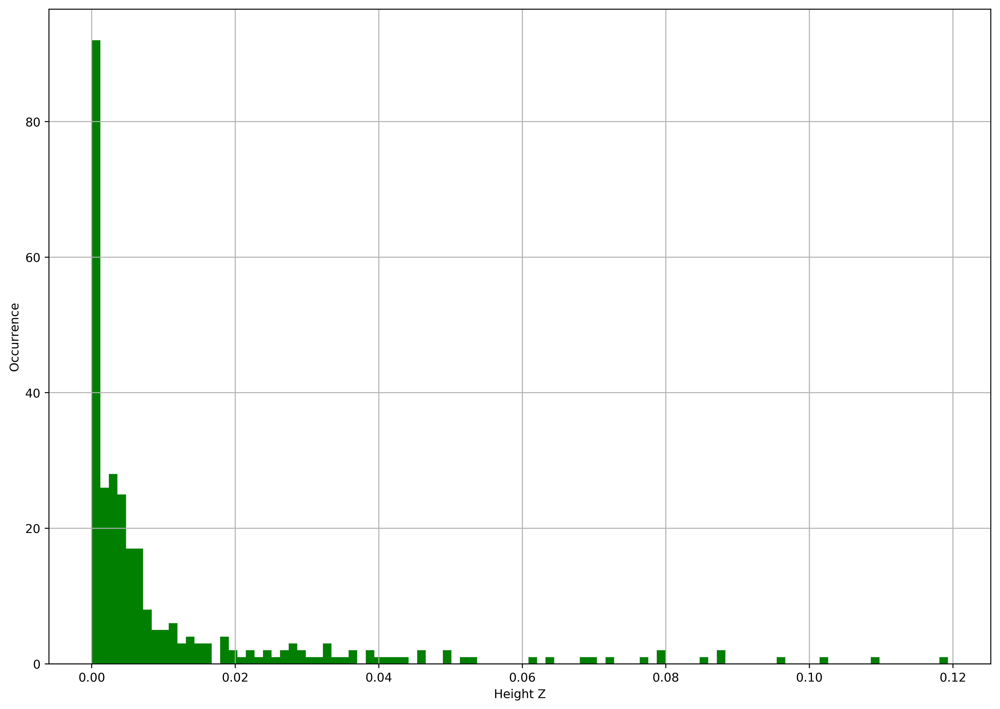

In [35]:
fig = plt.figure(figsize=(14,10), dpi=500)
ax = fig.gca()
ax.set_xlabel('Height Z')
ax.set_ylabel('Occurrence')
df10['z'].hist(bins=100, ax=ax, color='green')